11. What is the average duration of matches?

Loading Data:

In [1]:
import pandas as pd
from pathlib import Path
import matplotlib.pyplot as plt
import seaborn as sns


folder_path = Path('../data/input/raw_match_parquet')

# Time Data
time_dfs = []

for parquet_file in folder_path.glob('time_*.parquet'):
    try:
        df = pd.read_parquet(parquet_file)
        time_dfs.append(df)
        print(f"Successfully read {parquet_file.name}")
    except Exception as e:
        print(f"Error reading {parquet_file.name}: {e}")

if time_dfs:
    time_data = pd.concat(time_dfs, ignore_index=True)
    print("\n--- Combined Away Team DataFrame Info ---")
    print(time_data.shape)
    print(time_data.head())
    print(f"Successfully combined {len(time_dfs)} away team parquet files.")
else:
    print(f"No 'time_*.parquet' files found in {folder_path} or no files could be read.")

#Away Team Data
all_away_team_dfs = []

for parquet_file in folder_path.glob('away_team_*.parquet'):
    try:
        df = pd.read_parquet(parquet_file, columns=['match_id', 'country', 'gender', 'full_name'])
        all_away_team_dfs.append(df)
        print(f"Successfully read {parquet_file.name}")
    except Exception as e:
        print(f"Error reading {parquet_file.name}: {e}")

if all_away_team_dfs:
    away_team_data = pd.concat(all_away_team_dfs, ignore_index=True)
    print("\n--- Combined Away Team DataFrame Info ---")
    print(away_team_data.shape)
    print(away_team_data.head())
    print(f"Successfully combined {len(all_away_team_dfs)} away team parquet files.")
else:
    print(f"No 'away_team_*.parquet' files found in {folder_path} or no files could be read.")

# Home Team Data
all_home_team_dfs = []

for parquet_file in folder_path.glob('home_team_*.parquet'):
    try:
        df = pd.read_parquet(parquet_file, columns=['match_id', 'country', 'gender', 'full_name'])
        all_home_team_dfs.append(df)
        print(f"Successfully read {parquet_file.name}")
    except Exception as e:
        print(f"Error reading {parquet_file.name}: {e}")

if all_home_team_dfs:
    home_team_data = pd.concat(all_home_team_dfs, ignore_index=True)
    print("\n--- Combined Home Team DataFrame Info ---")
    print(home_team_data.shape)
    print(home_team_data.head())
    print(f"Successfully combined {len(all_home_team_dfs)} home team parquet files.")
else:
    print(f"No 'home_team_*.parquet' files found in {folder_path} or no files could be read.")

Successfully read time_11974049.parquet
Successfully read time_11974052.parquet
Successfully read time_11974053.parquet
Successfully read time_11974065.parquet
Successfully read time_11974066.parquet
Successfully read time_11974067.parquet
Successfully read time_11974068.parquet
Successfully read time_11974070.parquet
Successfully read time_11974071.parquet
Successfully read time_11974072.parquet
Successfully read time_11974113.parquet
Successfully read time_11987997.parquet
Successfully read time_11998445.parquet
Successfully read time_11998446.parquet
Successfully read time_11998447.parquet
Successfully read time_11998448.parquet
Successfully read time_11998449.parquet
Successfully read time_11998450.parquet
Successfully read time_11998451.parquet
Successfully read time_11998452.parquet
Successfully read time_11998453.parquet
Successfully read time_11998454.parquet
Successfully read time_11998455.parquet
Successfully read time_11998456.parquet
Successfully read time_11998457.parquet


Average Duration of Matches

C:\Users\Parsan Afzar\AppData\Local\Temp\ipykernel_2936\800926500.py:16: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=avg_duration, x='gender', y='total_duration_min', palette='Set2')


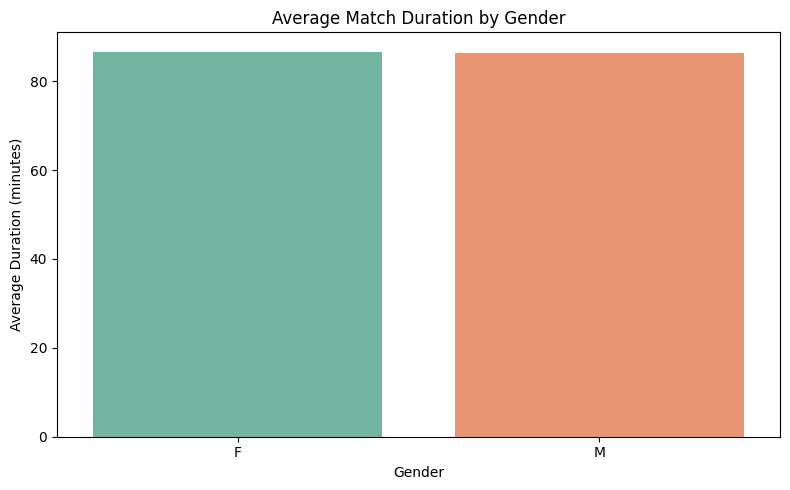

📊 Average match duration (in minutes) by gender:
  gender  total_duration_min
0      F           86.663935
1      M           86.359736


In [3]:
period_cols = ['period_1', 'period_2', 'period_3', 'period_4', 'period_5']
for col in period_cols:
    time_data[col] = pd.to_numeric(time_data[col], errors='coerce')

time_data['total_duration_sec'] = time_data[period_cols].sum(axis=1, skipna=True)
time_data['total_duration_min'] = time_data['total_duration_sec'] / 60

match_gender_df = home_team_data[['match_id', 'gender']].drop_duplicates()
time_gender_df = time_data.merge(match_gender_df, on='match_id', how='left')

time_gender_df = time_gender_df.dropna(subset=['total_duration_min', 'gender'])

avg_duration = time_gender_df.groupby('gender')['total_duration_min'].mean().reset_index()

plt.figure(figsize=(8, 5))
sns.barplot(data=avg_duration, x='gender', y='total_duration_min', palette='Set2')
plt.title('Average Match Duration by Gender')
plt.xlabel('Gender')
plt.ylabel('Average Duration (minutes)')
plt.tight_layout()

# Saving the output as png.
output_directory = Path('../data/output')
file_name = "Average Match Duration by Gender.png" 
full_path = output_directory / file_name
plt.savefig(full_path, dpi=300)

plt.show()

print("📊 Average match duration (in minutes) by gender:")
print(avg_duration)

Match Duration by Gender

C:\Users\Parsan Afzar\AppData\Local\Temp\ipykernel_2936\1025030931.py:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=avg_duration_country.head(10), y='country', x='total_duration_min', palette='coolwarm')


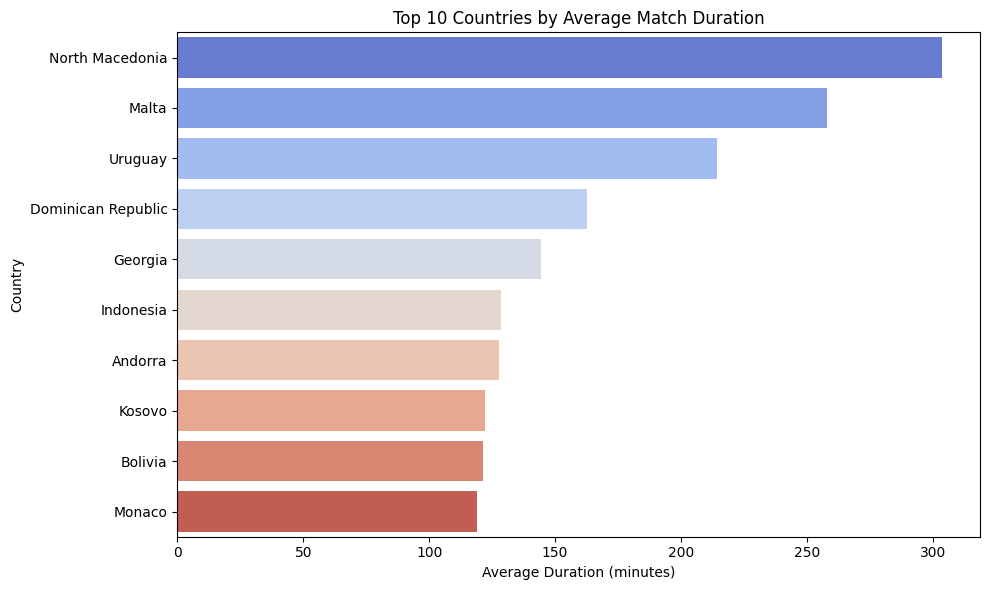

In [8]:
match_country_df = home_team_data[['match_id', 'country']].drop_duplicates()
time_country_df = time_data.merge(match_country_df, on='match_id', how='left')
time_country_df = time_country_df.dropna(subset=['total_duration_min', 'country'])

avg_duration_country = time_country_df.groupby('country')['total_duration_min'].mean().sort_values(ascending=False).reset_index()

plt.figure(figsize=(10, 6))
sns.barplot(data=avg_duration_country.head(10), y='country', x='total_duration_min', palette='coolwarm')
plt.title('Top 10 Countries by Average Match Duration')
plt.xlabel('Average Duration (minutes)')
plt.ylabel('Country')
plt.tight_layout()

# Saving the output as png.
output_directory = Path('../data/output')
file_name = "Top 10 Countries by Average Match Duration.png" 
full_path = output_directory / file_name
plt.savefig(full_path, dpi=300)

plt.show()

Match Duration by Full Name:

C:\Users\Parsan Afzar\AppData\Local\Temp\ipykernel_2936\3017406705.py:22: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=top10, y='player', x='total_duration_min', palette='magma')


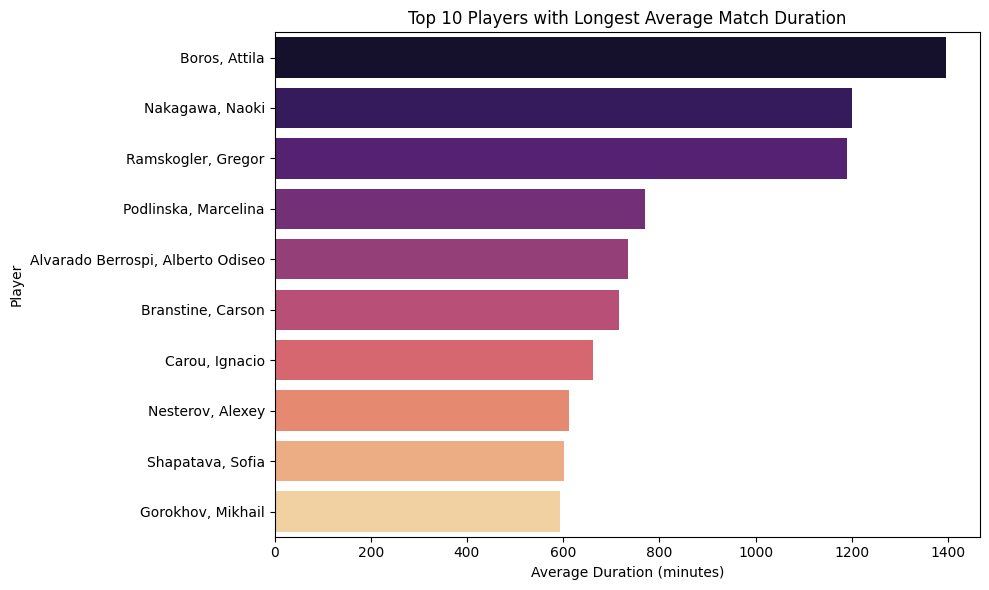

C:\Users\Parsan Afzar\AppData\Local\Temp\ipykernel_2936\3017406705.py:37: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=bottom10, y='player', x='total_duration_min', palette='Blues')


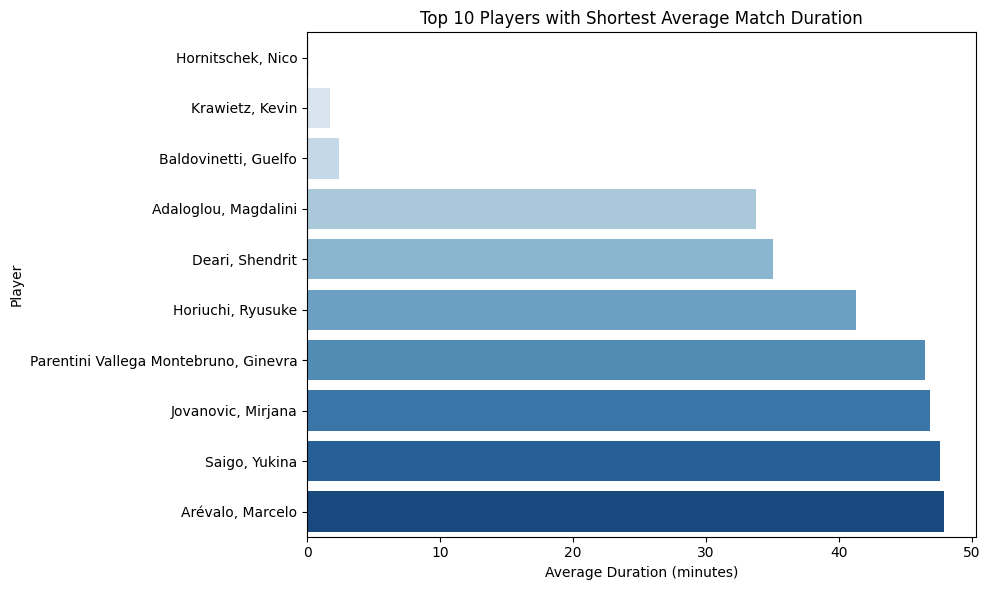


🟩 Players with the Longest Average Match Duration:
                                 player  total_duration_min
245                       Boros, Attila         1396.775000
1510                    Nakagawa, Naoki         1200.658333
1786                 Ramskogler, Gregor         1189.183333
1710               Podlinska, Marcelina          770.575000
43    Alvarado Berrospi, Alberto Odiseo          735.666667
272                   Branstine, Carson          715.361111
343                      Carou, Ignacio          662.280952
1533                   Nesterov, Alexey          612.666667
1988                   Shapatava, Sofia          600.866667
781                   Gorokhov, Mikhail          593.483333

🟦 Players with the Shortest Average Match Duration:
                                     player  total_duration_min
877                       Hornitschek, Nico            0.133333
1118                        Krawietz, Kevin            1.716667
118                    Baldovinetti, Guelfo

In [7]:
home_player_df = time_data.merge(home_team_data[['match_id', 'full_name']], on='match_id', how='left')
home_player_df = home_player_df[['match_id', 'full_name', 'total_duration_min']].dropna()
home_player_df = home_player_df.rename(columns={'full_name': 'player'})

away_player_df = time_data.merge(away_team_data[['match_id', 'full_name']], on='match_id', how='left')
away_player_df = away_player_df[['match_id', 'full_name', 'total_duration_min']].dropna()
away_player_df = away_player_df.rename(columns={'full_name': 'player'})

all_players_df = pd.concat([home_player_df, away_player_df], ignore_index=True)

player_durations = all_players_df.groupby('player')['total_duration_min'].mean().reset_index()

all_players_df = all_players_df.dropna(subset=['total_duration_min'])
all_players_df = all_players_df[all_players_df['total_duration_min'] > 0]

player_durations = all_players_df.groupby('player')['total_duration_min'].mean().reset_index()

top10 = player_durations.sort_values('total_duration_min', ascending=False).head(10)
bottom10 = player_durations.sort_values('total_duration_min', ascending=True).head(10)

plt.figure(figsize=(10, 6))
sns.barplot(data=top10, y='player', x='total_duration_min', palette='magma')
plt.title('Top 10 Players with Longest Average Match Duration')
plt.xlabel('Average Duration (minutes)')
plt.ylabel('Player')
plt.tight_layout()

# Saving the output as png.
output_directory = Path('../data/output')
file_name = "Top 10 Players with Longest Average Match Duration.png" 
full_path = output_directory / file_name
plt.savefig(full_path, dpi=300)

plt.show()

plt.figure(figsize=(10, 6))
sns.barplot(data=bottom10, y='player', x='total_duration_min', palette='Blues')
plt.title('Top 10 Players with Shortest Average Match Duration')
plt.xlabel('Average Duration (minutes)')
plt.ylabel('Player')
plt.tight_layout()

# Saving the output as png.
output_directory = Path('../data/output')
file_name = "Top 10 Players with Shortest Average Match Duration.png" 
full_path = output_directory / file_name
plt.savefig(full_path, dpi=300)

plt.show()

print("\n🟩 Players with the Longest Average Match Duration:")
print(top10)

print("\n🟦 Players with the Shortest Average Match Duration:")
print(bottom10)
